In [12]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from plotly.offline import init_notebook_mode, iplot
init_notebook_mode(connected=True)
import folium
from wordcloud import WordCloud

In [13]:
df = pd.read_csv("cargurus.csv")
df2 = pd.read_json("modelcode.json")

In [14]:
df.head()

,_id,text,year,model,zipcode,price,mileage
0,5f9703ba5011a7941e545b78,"Used 2021 BMW 8 Series for sale - $88,999 - 2,...",2021,c30831,12468,"88,999","2,000"
1,5f9703bb5011a7941e545b79,Used 2007 Mercedes-Benz R-Class R 350 4MATIC f...,2007,c6253,12928,"5,555","133,137"
2,5f9703bb5011a7941e545b7a,Used 2007 Mercedes-Benz R-Class R 320 CDI 4MAT...,2007,c6253,12928,"7,999","117,210"
3,5f9703bb5011a7941e545b7b,Used 2007 Mercedes-Benz R-Class R 350 4MATIC f...,2007,c6253,12928,"7,995","98,477"
4,5f9703bb5011a7941e545b7c,Used 2007 Mercedes-Benz R-Class R 350 4MATIC f...,2007,c6253,12928,"7,900","114,476"


In [15]:
df2.head()

,_id,year,make,model,code
0,{'$oid': '5f96f08c8ba96e2546164302'},2020,Acura,MDX,c29535
1,{'$oid': '5f96f08e8ba96e2546164303'},2019,Acura,MDX,c27735
2,{'$oid': '5f96f08e8ba96e2546164304'},2018,Acura,MDX,c27203
3,{'$oid': '5f96f08f8ba96e2546164305'},2017,Acura,MDX,c25860
4,{'$oid': '5f96f08f8ba96e2546164306'},2016,Acura,MDX,c24806


In [16]:
df['price'] = df['price'].str.replace(',', '')
df['mileage'] = df['mileage'].str.replace(',', '')
df['mileage'] = df['mileage'].astype(int)

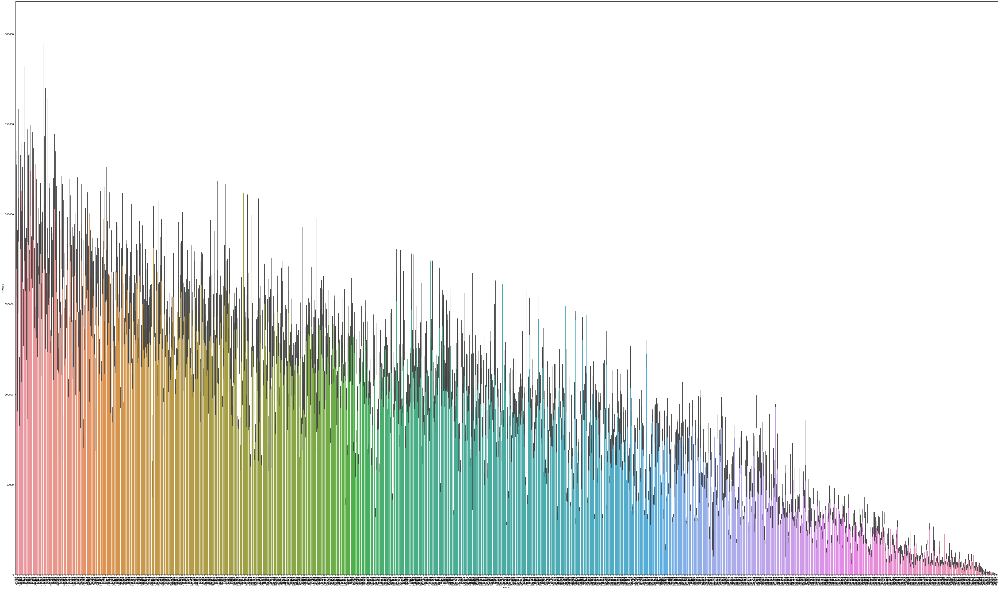

In [32]:
df=df.sort_values(by=['mileage'],ascending=False)
plt.figure(figsize=(75,45))
sns.barplot(x=df['model'], y=df['mileage'])
plt.xticks(rotation= 90)
plt.xlabel('model')
plt.ylabel('mileage')
plt.show()

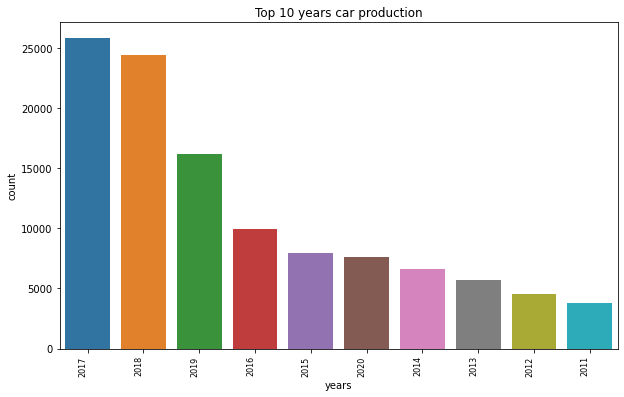

In [33]:
plt.figure(figsize=(10,6))
years = df['year'].value_counts().iloc[:10]
years = pd.DataFrame({'years' : years.index.astype(int), 'count' : years.values.astype(int)})
ax = sns.barplot(x='years', y='count', data=years, order = years['years']);
ax.set_xticklabels(ax.get_xticklabels(), rotation=90, ha="right",fontsize=8);
plt.title("Top 10 years car production");# fig = plt.figure(figsize = (20,20))

In [18]:
import sweetviz

In [22]:
report = sweetviz.analyze([df,'df'],target_feat='mileage')
report.show_html('report.html')


Report report.html was generated! NOTEBOOK/COLAB USERS: the web browser MAY not pop up, regardless, the report IS saved in your notebook/colab files.


In [26]:
from uszipcode import SearchEngine, SimpleZipcode, Zipcode
search = SearchEngine()
def zco(x):
    city = search.by_zipcode(x).major_city
    return city if city else 'None'
df['City'] = df['zipcode'].fillna(0).astype(int).apply(zco)

In [27]:
df.head()

,_id,text,year,model,zipcode,price,mileage,City
0,5f9703ba5011a7941e545b78,"Used 2021 BMW 8 Series for sale - $88,999 - 2,...",2021,c30831,12468,88999,2000,Prattsville
1,5f9703bb5011a7941e545b79,Used 2007 Mercedes-Benz R-Class R 350 4MATIC f...,2007,c6253,12928,5555,133137,Crown Point
2,5f9703bb5011a7941e545b7a,Used 2007 Mercedes-Benz R-Class R 320 CDI 4MAT...,2007,c6253,12928,7999,117210,Crown Point
3,5f9703bb5011a7941e545b7b,Used 2007 Mercedes-Benz R-Class R 350 4MATIC f...,2007,c6253,12928,7995,98477,Crown Point
4,5f9703bb5011a7941e545b7c,Used 2007 Mercedes-Benz R-Class R 350 4MATIC f...,2007,c6253,12928,7900,114476,Crown Point


In [66]:
search = SearchEngine()
def zco(x):
    city = search.by_zipcode(x).lat
    return city if city else 0
df['lat'] = df['zipcode'].fillna(0).astype(int).apply(zco)

In [67]:
search = SearchEngine()
def zco(x):
    city = search.by_zipcode(x).lng
    return city if city else 0
df['lng'] = df['zipcode'].fillna(0).astype(int).apply(zco)

In [68]:
df.head()

,_id,text,year,model,zipcode,price,mileage,City,lat,lng
0,5f9703ba5011a7941e545b78,"Used 2021 BMW 8 Series for sale - $88,999 - 2,...",2021,c30831,12468,88999,2000,Prattsville,42.3,-74.4
1,5f9703bb5011a7941e545b79,Used 2007 Mercedes-Benz R-Class R 350 4MATIC f...,2007,c6253,12928,5555,133137,Crown Point,44.0,-73.5
2,5f9703bb5011a7941e545b7a,Used 2007 Mercedes-Benz R-Class R 320 CDI 4MAT...,2007,c6253,12928,7999,117210,Crown Point,44.0,-73.5
3,5f9703bb5011a7941e545b7b,Used 2007 Mercedes-Benz R-Class R 350 4MATIC f...,2007,c6253,12928,7995,98477,Crown Point,44.0,-73.5
4,5f9703bb5011a7941e545b7c,Used 2007 Mercedes-Benz R-Class R 350 4MATIC f...,2007,c6253,12928,7900,114476,Crown Point,44.0,-73.5


In [73]:
df.to_csv('out.csv')

In [ ]:
df2.to_csv('code.csv')

In [70]:
import plotly.graph_objects as go

In [71]:
df['lng'] = df['lng'].fillna(0).astype(float)

In [72]:
import plotly.express as px

fig = px.scatter_mapbox(df, lat="lat", lon="lng", hover_name="City", hover_data=["price", "mileage"],
                        color_discrete_sequence=["fuchsia"], zoom=3, height=300)
fig.update_layout(mapbox_style="open-street-map")
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

In [74]:
report = sweetviz.analyze([df,'df'],target_feat='mileage')
report.show_html('report.html')


Report report.html was generated! NOTEBOOK/COLAB USERS: the web browser MAY not pop up, regardless, the report IS saved in your notebook/colab files.


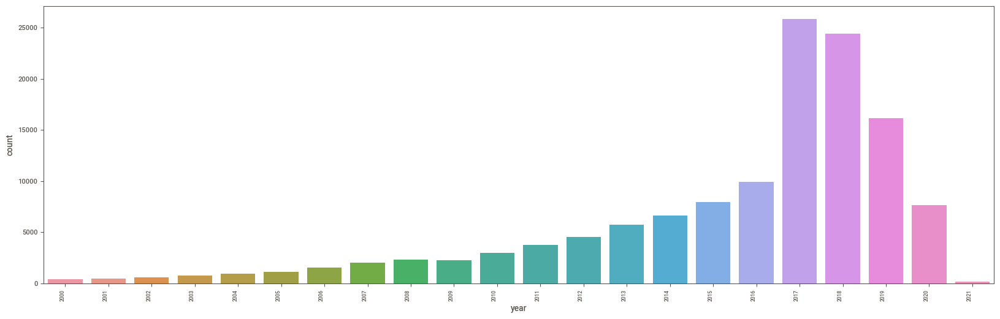

In [76]:
plt.figure(figsize=(20,6))
ax = sns.countplot(x='year',data=df);
ax.set_xticklabels(ax.get_xticklabels(), rotation=90, ha="right",fontsize=6);